In [14]:
import warnings
warnings.filterwarnings('ignore')
caffe_root = '/home/GRAPHICS2/hse_ashevchenko/SegNet_caffe/caffe-segnet/'
import sys
sys.path.insert(0, caffe_root + 'python')
import caffe

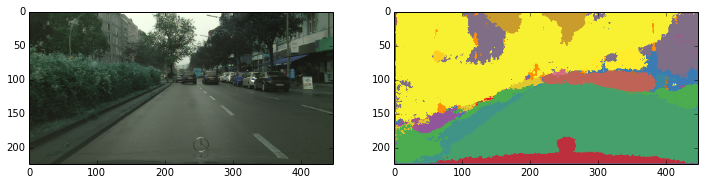

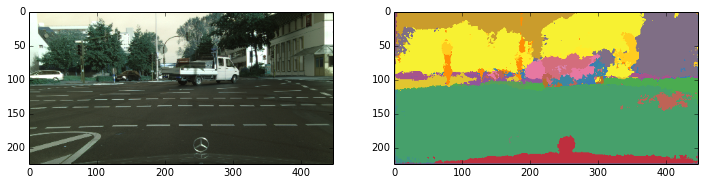

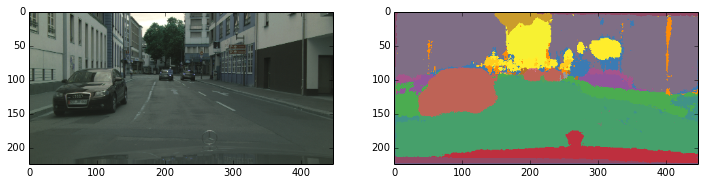

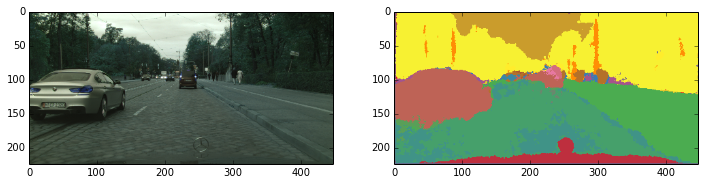

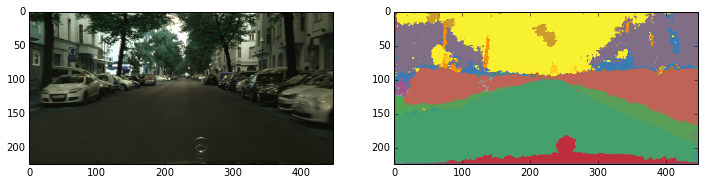

...

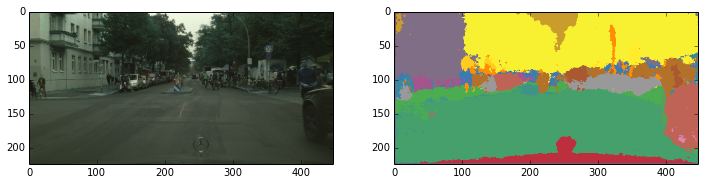

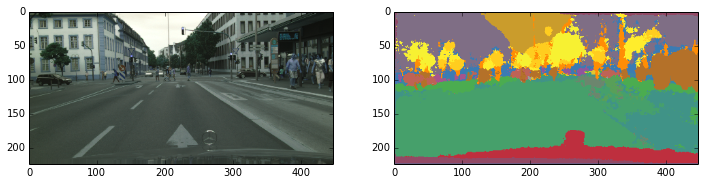

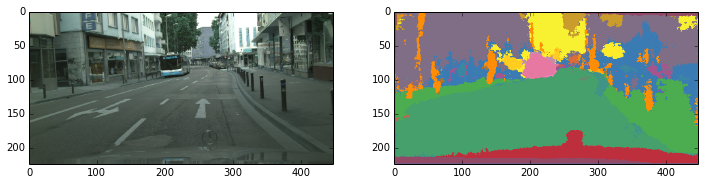

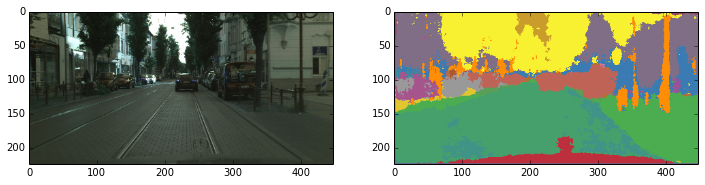

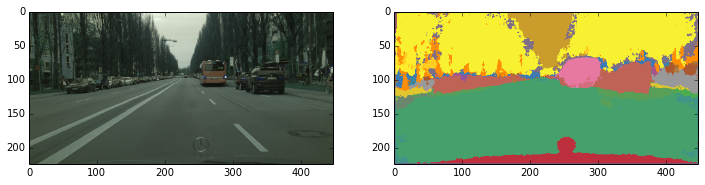

Success!


In [16]:
import numpy as np
import matplotlib.pyplot as plt
import os.path
import json
import scipy
import argparse
import math
import pylab
from sklearn.preprocessing import normalize
%matplotlib inline

args = ('SegNet-Tutorial/Models/segnet_inference_no_cw.prototxt', 'Inference/test_weights.caffemodel', 300)

caffe.set_mode_gpu()
caffe.set_device(0)

net = caffe.Net(args[0],
                args[1],
                caffe.TEST)



for i in range(0, args[2]):

    net.forward()

    image = net.blobs['data'].data
    label = net.blobs['label'].data
    predicted = net.blobs['prob'].data
    image = np.rollaxis(np.squeeze(image[0,:,:,:]), 0, 3)
    output = np.squeeze(predicted[0,:,:,:])
    ind = np.argmax(output, axis=0)

    label_colours = np.array([ [ 0.89411765,  0.10196079,  0.10980392],
                               [ 0.7451288 ,  0.18808151,  0.24415225],
                               [ 0.57485583,  0.28650519,  0.3976932 ],
                               [ 0.40458286,  0.38492887,  0.55123415],
                               [ 0.23430988,  0.48335256,  0.7047751 ],
                               [ 0.23226452,  0.53104191,  0.63867745],
                               [ 0.25391773,  0.57926952,  0.5304114 ],
                               [ 0.27557094,  0.62749713,  0.42214534],
                               [ 0.29722416,  0.67572474,  0.31387929],
                               [ 0.3504037 ,  0.6236217 ,  0.34768167],
                               [ 0.42422147,  0.52815073,  0.43527876],
                               [ 0.49803924,  0.43267975,  0.52287584],
                               [ 0.571857  ,  0.33720878,  0.61047292],
                               [ 0.65151867,  0.33225683,  0.55148022],
                               [ 0.75289506,  0.38048444,  0.39104961],
                               [ 0.85427144,  0.42871204,  0.230619  ],
                               [ 0.95564783,  0.47693964,  0.07018839],
                               [ 1.        ,  0.55315648,  0.02196078],
                               [ 1.        ,  0.67913879,  0.07215686],
                               [ 1.        ,  0.80512111,  0.12235294],
                               [ 1.        ,  0.93110342,  0.17254902],
                               [ 0.97125721,  0.94542099,  0.19644752],
                               [ 0.88366014,  0.77908497,  0.18562092],
                               [ 0.79606306,  0.61274895,  0.17479431],
                               [ 0.70846599,  0.44641293,  0.16396771],
                               [ 0.66841986,  0.34651289,  0.18937332],
                               [ 0.74814304,  0.38883508,  0.33799309],
                               [ 0.82786622,  0.43115727,  0.48661285],
                               [ 0.90758939,  0.47347946,  0.63523262],
                               [ 0.95850827,  0.508466  ,  0.74492889],
                               [ 0.86599001,  0.53208769,  0.70752789],
                               [ 0.77347176,  0.55570937,  0.67012689],
                               [ 0.6809535 ,  0.57933105,  0.6327259 ],
                               [ 0.60000002,  0.60000002,  0.60000002] ])
    
    labels = np.zeros((224, 448, 3))
    for i in range(output.shape[1]):
        for j in range(output.shape[2]):
            labels[i,j,:] = label_colours[np.argmax(output[:,i,j])]
    #plt.imshow(image)
    plt.figure(figsize=(12,5))
    plt.subplot(1, 2, 1)
    plt.imshow(image / 255.)
    plt.subplot(1, 2, 2)
    plt.imshow(labels)
    plt.show()
    


print 'Success!'